#Conditional generative adversarial network (CGAN)

A cGAN is a kind of GAN that can create images based on some conditions given to a generator model.

In this project we are going to generate CGAN on MNIST hand-written digits by using Tensorflow librariy.

# Import Libraries

If we are using Colab, we should connect our Google Drive to the Notebook for some operation like save and read model.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from numpy import zeros
from numpy import ones
from numpy.random import randint
from keras.optimizers import Adam
from matplotlib import pyplot
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
import keras
import random
from keras.datasets.mnist import load_data
from keras.models import Model, Sequential
from keras.layers import Activation, Dense, Flatten, BatchNormalization, Dropout, LeakyReLU, Input, Reshape, multiply
from keras.layers import Embedding
from keras.utils.vis_utils import plot_model

# Creat CGAN

The CGAN model is included with two part: a generator and a discriminator. The generator is a neural network (for example MLP or CNN) which makes new examples that look like the real ones in the dataset. Also, The discriminator is a neural network that tries to tell apart the real images from the fake ones.

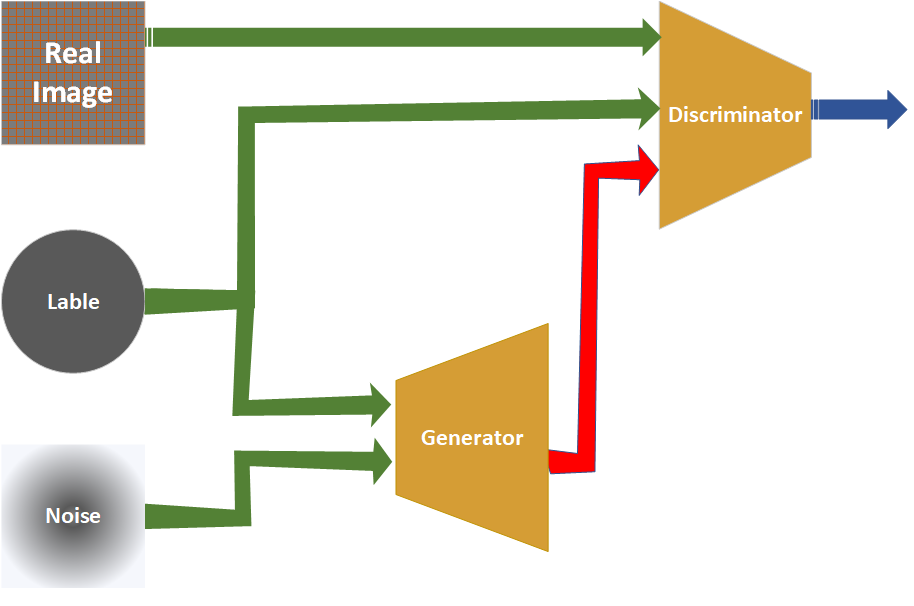


## Build Discriminator

In this section, we are going to design a discriminator model by using Dense layers. You can also design your discriminator model by using convolutional layers, which in this case refers to DCGAN.

In [ ]:
def discriminator(in_shape=(28,28,1), n_classes=10):
  img = Input(shape=in_shape)                                                   #Shape of input image
  label = Input(shape=(1,), dtype='int32')                                      #Shape of input label
  label_embedding = Flatten()(Embedding(10, np.prod(in_shape))(label))          #This command creates an embedding layer that maps positive integers (indexes) to dense vectors of fixed size. The input dimension is 10, which means the vocabulary size is 10.
  flat_img = Flatten()(img)                                                     #It reshapes the input tensor to have a single dimension.

  merge = multiply([flat_img, label_embedding])                                 #This command mege input image and lable for creat input of Discriminator model
                                                                                #for this reason it performs element-wise multiplication of a list of inputs. It takes as input a list of tensors, all of the same shape, and returns a single tensor of the same shape.
  de_model = Dense(512, input_dim=np.prod(in_shape))(merge)
  de_model = LeakyReLU(alpha=0.2)(de_model)
  de_model = Dense(512)(de_model)
  de_model = LeakyReLU(alpha=0.2)(de_model)
  de_model = Dropout(0.4)(de_model)
  de_model = Dense(512)(de_model)
  de_model = LeakyReLU(alpha=0.2)(de_model)
  de_model = Dropout(0.4)(de_model)

  out_layer = Dense(1, activation='sigmoid')(de_model)                          #Define output layer

  model = Model([img, label], out_layer)                                        #Define model with inputs and output layers

  return model

In [ ]:
print(discriminator().summary())                                                #Print model charactrization

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 input_1 (InputLayer)           [(None, 28, 28, 1)]  0           []                               
                                                                                                  
 embedding (Embedding)          (None, 1, 784)       7840        ['input_2[0][0]']                
                                                                                                  
 flatten_1 (Flatten)            (None, 784)          0           ['input_1[0][0]']                
                                                                                              

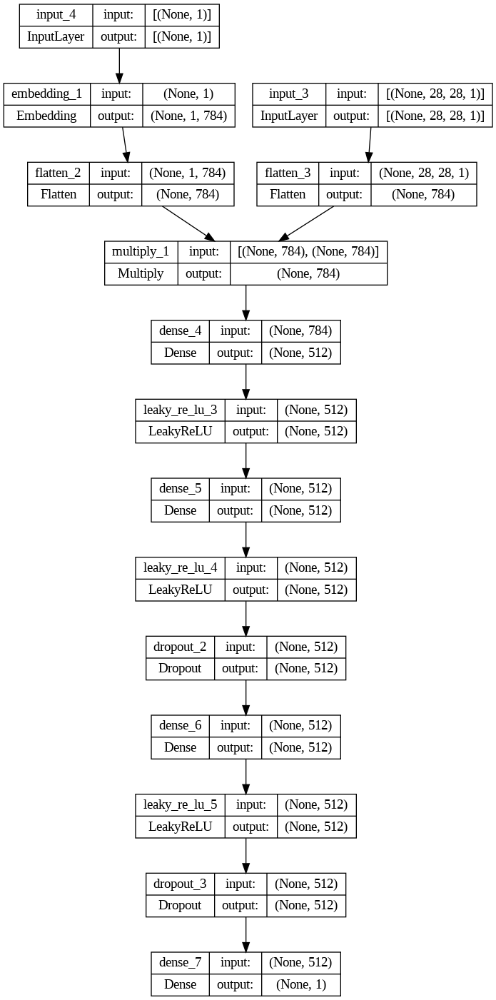

In [ ]:
plot_model(discriminator(), to_file='model_plot.png', show_shapes=True, show_layer_names=True) #Draw a graph of model

## Build Generator

In this section, we are going to design a Generator model by using Dense layers. as previous model (Discriminator) you can design your Generator model by using convolutional layers, which in this case refers to DCGAN.

In [ ]:
def generator(latent_dim=100, n_classes=10):
  label = Input(shape=(1,), dtype='int32')                                      #Shape of input label
  label_embedding = Flatten()(Embedding(n_classes, latent_dim)(label))          #Embedding input
  latent = Input(shape=(latent_dim,))                                           #Shape of input noise

  merge = multiply([latent, label_embedding])                                   #merge two input

  ge_model = Dense(256, input_dim=latent_dim)(merge)
  ge_model = LeakyReLU(alpha=0.2)(ge_model)
  ge_model = BatchNormalization(momentum=0.8)(ge_model)

  ge_model = Dense(512)(ge_model)
  ge_model = LeakyReLU(alpha=0.2)(ge_model)
  ge_model = BatchNormalization(momentum=0.8)(ge_model)

  ge_model = Dense(1024)(ge_model)
  ge_model = LeakyReLU(alpha=0.2)(ge_model)
  ge_model = BatchNormalization(momentum=0.8)(ge_model)

  ge_model = Dense(np.prod((28,28,1)), activation='tanh')(ge_model)
  output = Reshape((28,28,1))(ge_model)

  model = Model([latent, label], output)                                        #Define model with inputs and output layers
  return model

In [ ]:
print(generator().summary())                                                    #Print model charactrization

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 embedding_2 (Embedding)        (None, 1, 100)       1000        ['input_5[0][0]']                
                                                                                                  
 input_6 (InputLayer)           [(None, 100)]        0           []                               
                                                                                                  
 flatten_4 (Flatten)            (None, 100)          0           ['embedding_2[0][0]']            
                                                                                            

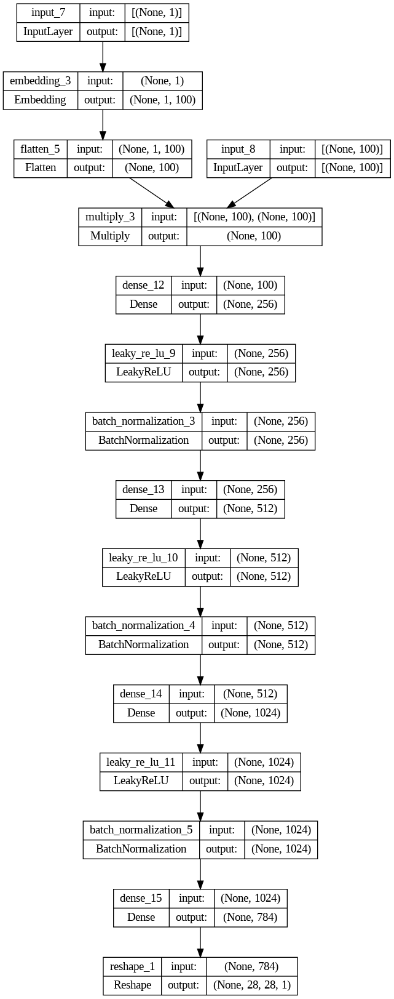

In [ ]:
plot_model(generator(), to_file='model_plot.png', show_shapes=True, show_layer_names=True)  #Draw a graph of model

## Build CGAN model

Finally, after designing the generator and the discriminator, we should combine these two models for generating the GAN model. For this, first it is necessary to have some knowledge about the training pattern of the CGAN or GAN model.

In the case of training the CGAN, the discriminator is trained first. Then the trainability of the discriminator model is turned off and the generator produces fake images according to its inputs (label and noise). Finally, the fake images serve as input for the discriminator.

Hence, the CGAN is modeled as noise and label inputs and detection result of the discriminator as output.

In [ ]:
discriminator = discriminator()
generator = generator()
discriminator.compile(loss=['binary_crossentropy'], optimizer=Adam(0.0002, 0.5), metrics=['accuracy'])

noise = Input(shape=(100,))
label = Input(shape=(1,))
img = generator([noise, label])

discriminator.trainable = False

valid = discriminator([img, label])
combined = Model([noise, label], valid)

combined.compile(loss=['binary_crossentropy'], optimizer=Adam(0.0002, 0.5))

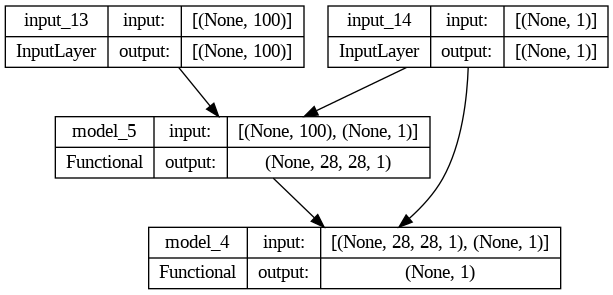

In [ ]:
plot_model(combined, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

# Split Dataset and Preprocessing

In [ ]:
(x_train, y_train), (x_test, y_test) = load_data()                              #Load dataset
X_train = (x_train.astype(np.float32) - 127.5) / 127.5                          #Normalize dataset
X_train = np.expand_dims(X_train, axis=3)
y_train = y_train.reshape(-1, 1)

11490434/11490434 [==============================] - 0s 0us/step


In [ ]:
list_num=np.arange(60000)
np.random.shuffle(list_num)
list_split=np.split(list_num,X_train.shape[0]/32)

#Creat rand_labels array for produce some images by generator for visualise model in each eapoch

In [ ]:
rand_labels = [[0],[0],[0],[0],[0],[0],[0],[0],[0],[0],
          [1],[1],[1],[1],[1],[1],[1],[1],[1],[1],
          [2],[2],[2],[2],[2],[2],[2],[2],[2],[2],
          [3],[3],[3],[3],[3],[3],[3],[3],[3],[3],
          [4],[4],[4],[4],[4],[4],[4],[4],[4],[4],
          [5],[5],[5],[5],[5],[5],[5],[5],[5],[5],
          [6],[6],[6],[6],[6],[6],[6],[6],[6],[6],
          [7],[7],[7],[7],[7],[7],[7],[7],[7],[7],
          [8],[8],[8],[8],[8],[8],[8],[8],[8],[8],
          [9],[9],[9],[9],[9],[9],[9],[9],[9],[9]]
rand_labels=np.array(rand_labels)

# Training

1/1 [==============================] - 0s 16ms/step
Epoch = %d 0
4/4 [==============================] - 0s 3ms/step


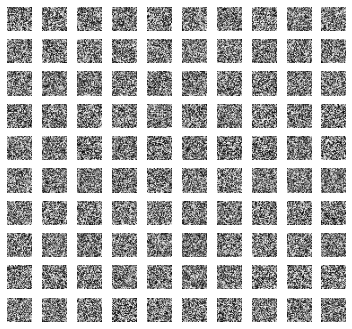

1/1 [==============================] - 0s 14ms/step
Epoch = %d 1
4/4 [==============================] - 0s 4ms/step


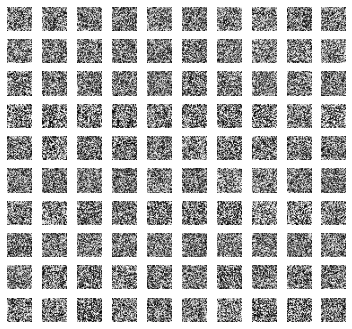

1/1 [==============================] - 0s 17ms/step
Epoch = %d 2
4/4 [==============================] - 0s 4ms/step


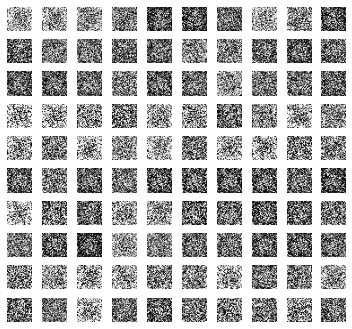

1/1 [==============================] - 0s 15ms/step
Epoch = %d 3
4/4 [==============================] - 0s 3ms/step


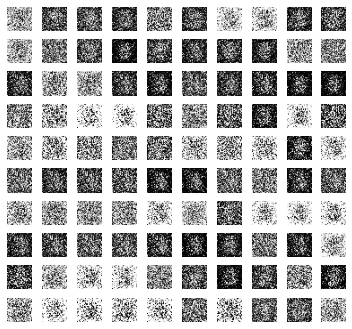

1/1 [==============================] - 0s 18ms/step
Epoch = %d 4
4/4 [==============================] - 0s 3ms/step


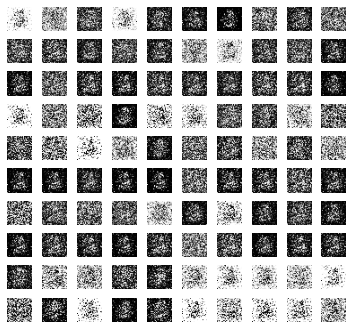

1/1 [==============================] - 0s 13ms/step
Epoch = %d 5
4/4 [==============================] - 0s 5ms/step


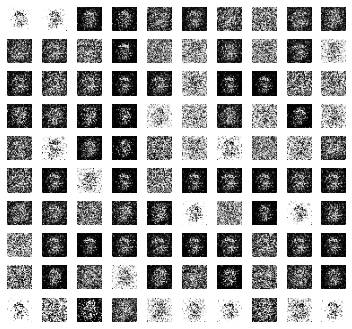

1/1 [==============================] - 0s 14ms/step
Epoch = %d 6
4/4 [==============================] - 0s 4ms/step


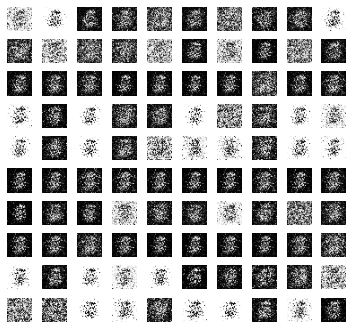

1/1 [==============================] - 0s 17ms/step
Epoch = %d 7
4/4 [==============================] - 0s 6ms/step


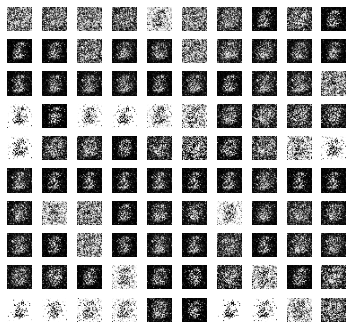

1/1 [==============================] - 0s 15ms/step
Epoch = %d 8
4/4 [==============================] - 0s 5ms/step


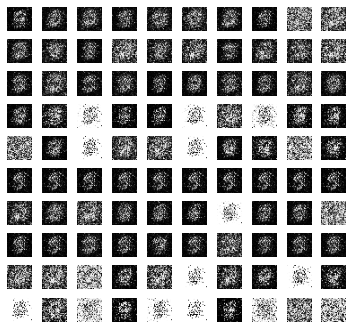

1/1 [==============================] - 0s 16ms/step
Epoch = %d 9
4/4 [==============================] - 0s 3ms/step


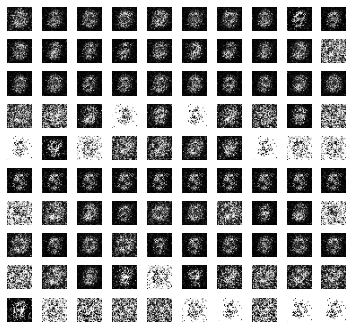

1/1 [==============================] - 0s 14ms/step
Epoch = %d 10
4/4 [==============================] - 0s 6ms/step


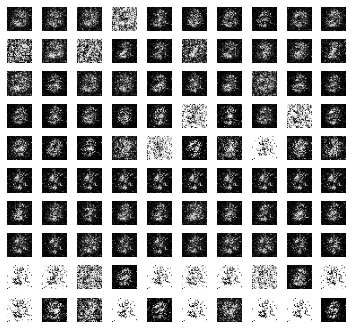

1/1 [==============================] - 0s 15ms/step
Epoch = %d 11
4/4 [==============================] - 0s 4ms/step


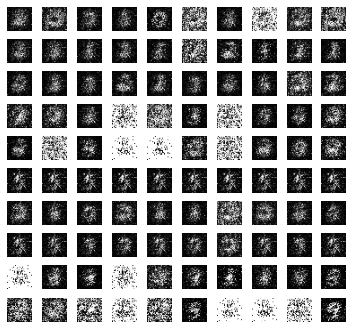

1/1 [==============================] - 0s 62ms/step
Epoch = %d 12
4/4 [==============================] - 0s 5ms/step


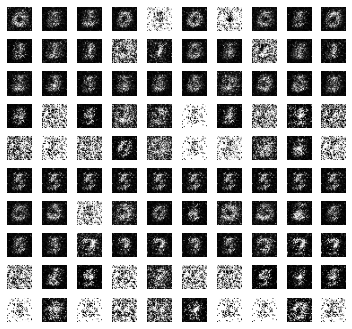

1/1 [==============================] - 0s 15ms/step
Epoch = %d 13
4/4 [==============================] - 0s 3ms/step


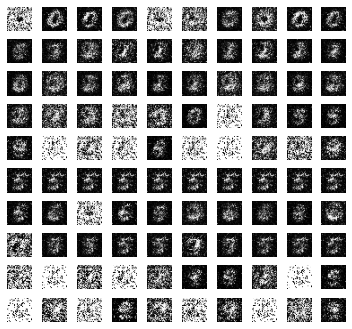

1/1 [==============================] - 0s 19ms/step
Epoch = %d 14
4/4 [==============================] - 0s 6ms/step


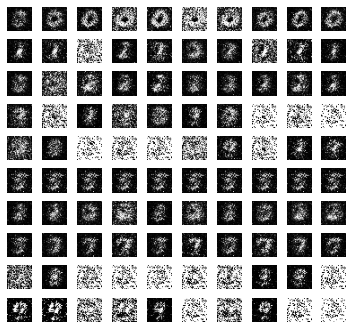

1/1 [==============================] - 0s 15ms/step
Epoch = %d 15
4/4 [==============================] - 0s 3ms/step


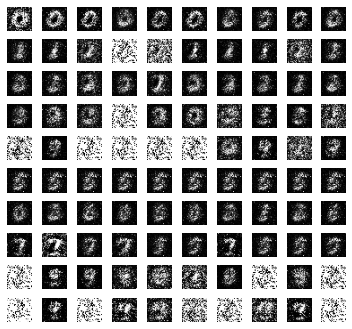

1/1 [==============================] - 0s 19ms/step
Epoch = %d 16
4/4 [==============================] - 0s 4ms/step


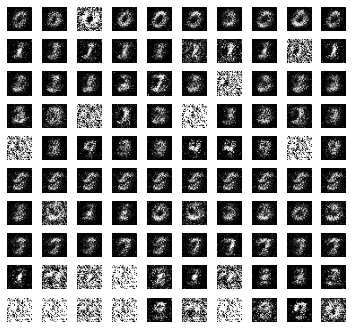

1/1 [==============================] - 0s 14ms/step
Epoch = %d 17
4/4 [==============================] - 0s 5ms/step


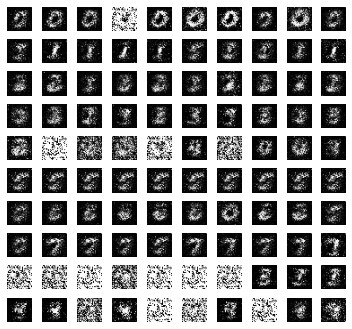

1/1 [==============================] - 0s 20ms/step
Epoch = %d 18
4/4 [==============================] - 0s 3ms/step


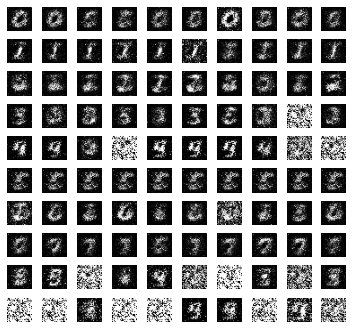

1/1 [==============================] - 0s 20ms/step
Epoch = %d 19
4/4 [==============================] - 0s 3ms/step


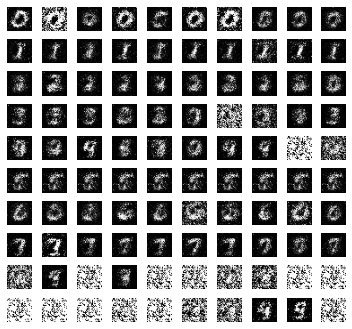

1/1 [==============================] - 0s 17ms/step
Epoch = %d 20
4/4 [==============================] - 0s 3ms/step


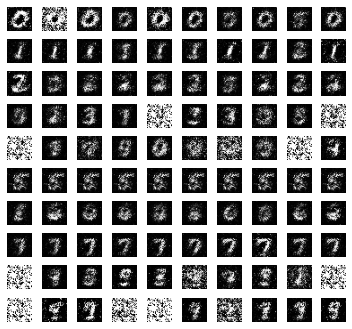

1/1 [==============================] - 0s 20ms/step
Epoch = %d 21
4/4 [==============================] - 0s 3ms/step


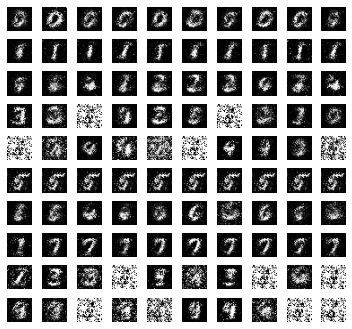

1/1 [==============================] - 0s 23ms/step
Epoch = %d 22
4/4 [==============================] - 0s 3ms/step


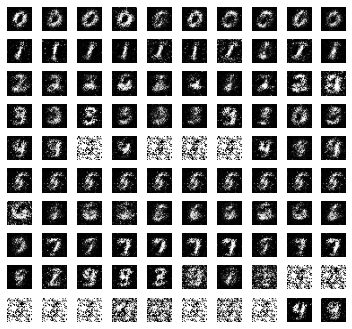

1/1 [==============================] - 0s 23ms/step
Epoch = %d 23
4/4 [==============================] - 0s 3ms/step


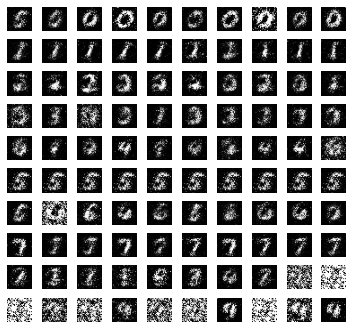

1/1 [==============================] - 0s 25ms/step
Epoch = %d 24
4/4 [==============================] - 0s 3ms/step


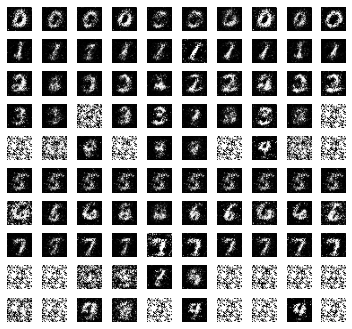

1/1 [==============================] - 0s 20ms/step
Epoch = %d 25
4/4 [==============================] - 0s 3ms/step


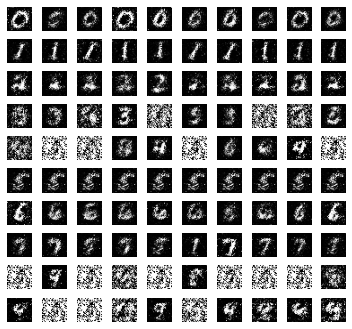

1/1 [==============================] - 0s 20ms/step
Epoch = %d 26
4/4 [==============================] - 0s 4ms/step


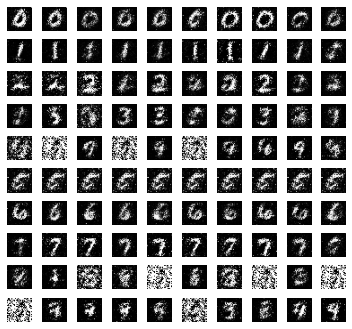

1/1 [==============================] - 0s 21ms/step
Epoch = %d 27
4/4 [==============================] - 0s 3ms/step


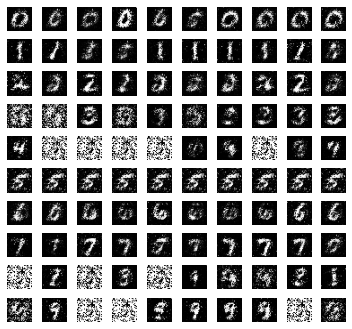

1/1 [==============================] - 0s 19ms/step
Epoch = %d 28
4/4 [==============================] - 0s 3ms/step


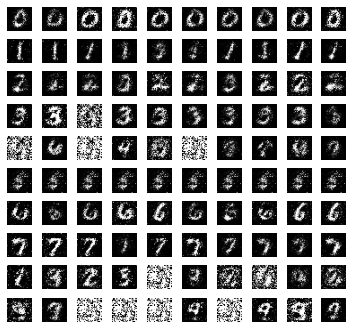

1/1 [==============================] - 0s 21ms/step
Epoch = %d 29
4/4 [==============================] - 0s 6ms/step


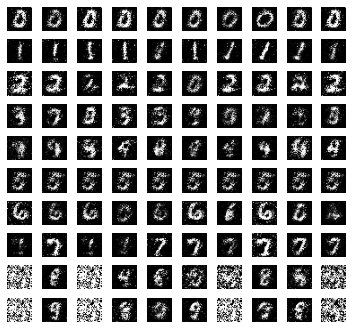

1/1 [==============================] - 0s 24ms/step
Epoch = %d 30
4/4 [==============================] - 0s 3ms/step


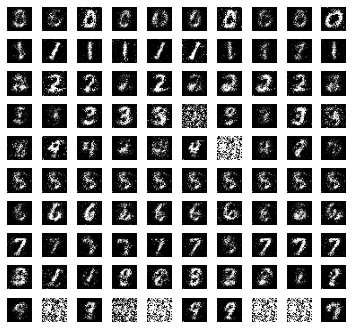

1/1 [==============================] - 0s 22ms/step
Epoch = %d 31
4/4 [==============================] - 0s 4ms/step


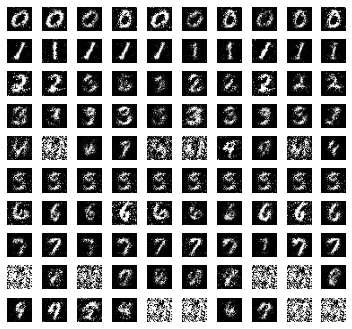

1/1 [==============================] - 0s 22ms/step
Epoch = %d 32
4/4 [==============================] - 0s 4ms/step


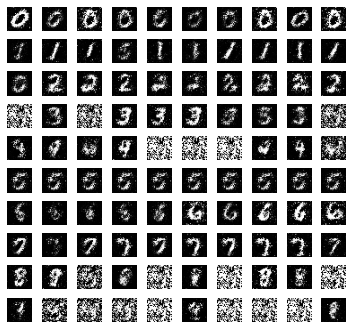

1/1 [==============================] - 0s 20ms/step
Epoch = %d 33
4/4 [==============================] - 0s 4ms/step


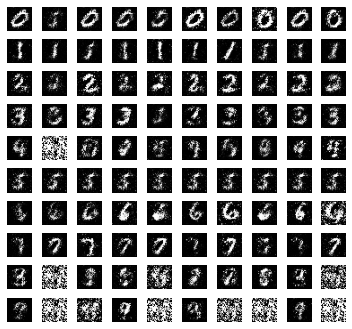

1/1 [==============================] - 0s 21ms/step
Epoch = %d 34
4/4 [==============================] - 0s 3ms/step


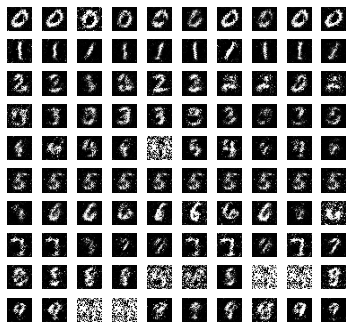

1/1 [==============================] - 0s 22ms/step
Epoch = %d 35
4/4 [==============================] - 0s 4ms/step


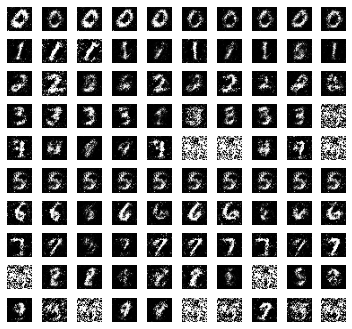

1/1 [==============================] - 0s 20ms/step
Epoch = %d 36
4/4 [==============================] - 0s 5ms/step


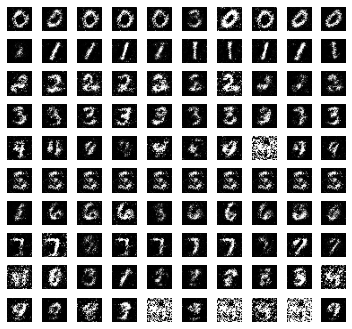

1/1 [==============================] - 0s 23ms/step
Epoch = %d 37
4/4 [==============================] - 0s 4ms/step


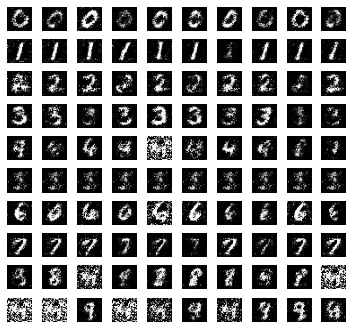

1/1 [==============================] - 0s 21ms/step
Epoch = %d 38
4/4 [==============================] - 0s 4ms/step


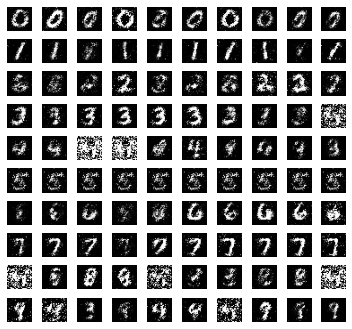

1/1 [==============================] - 0s 21ms/step
Epoch = %d 39
4/4 [==============================] - 0s 4ms/step


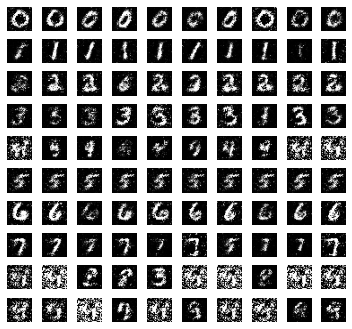

1/1 [==============================] - 0s 20ms/step
Epoch = %d 40
4/4 [==============================] - 0s 5ms/step


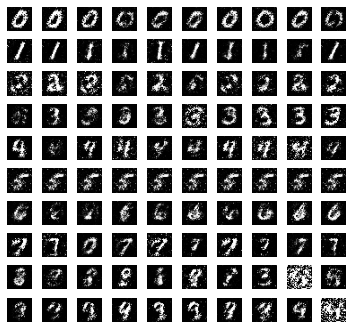

1/1 [==============================] - 0s 31ms/step
Epoch = %d 41
4/4 [==============================] - 0s 3ms/step


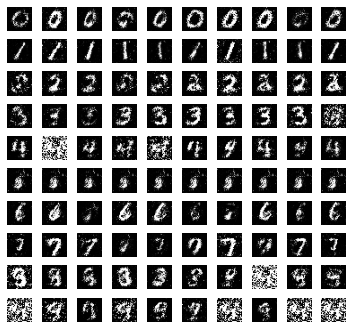

1/1 [==============================] - 0s 24ms/step
Epoch = %d 42
4/4 [==============================] - 0s 3ms/step


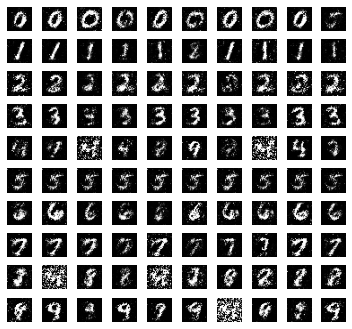

1/1 [==============================] - 0s 23ms/step
Epoch = %d 43
4/4 [==============================] - 0s 4ms/step


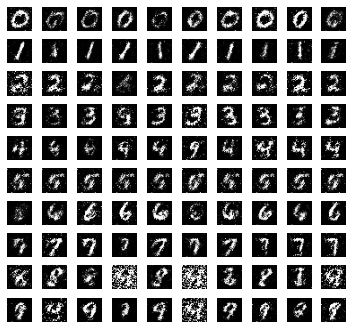

1/1 [==============================] - 0s 21ms/step
Epoch = %d 44
4/4 [==============================] - 0s 5ms/step


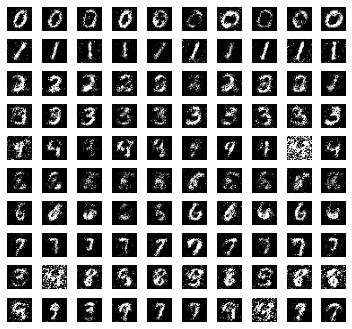

1/1 [==============================] - 0s 20ms/step
Epoch = %d 45
4/4 [==============================] - 0s 4ms/step


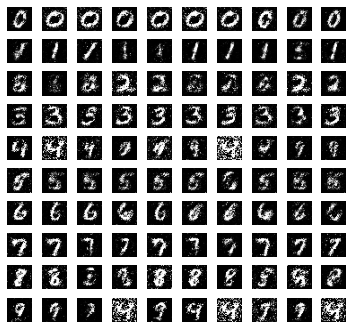

1/1 [==============================] - 0s 22ms/step
Epoch = %d 46
4/4 [==============================] - 0s 4ms/step


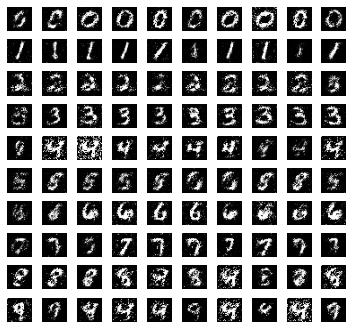

1/1 [==============================] - 0s 20ms/step
Epoch = %d 47
4/4 [==============================] - 0s 3ms/step


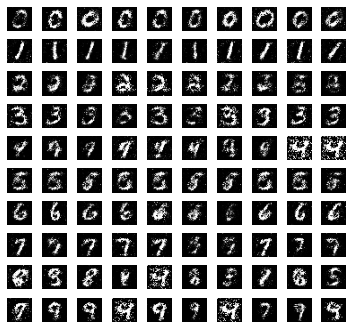

1/1 [==============================] - 0s 21ms/step
Epoch = %d 48
4/4 [==============================] - 0s 4ms/step


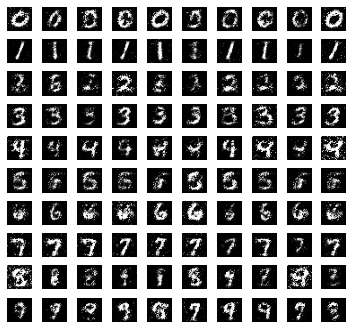

1/1 [==============================] - 0s 22ms/step
Epoch = %d 49
4/4 [==============================] - 0s 4ms/step


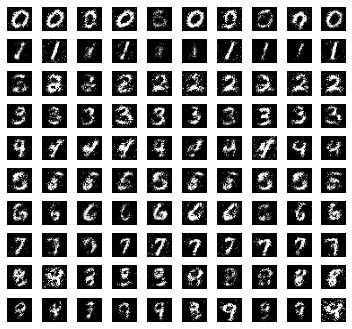

1/1 [==============================] - 0s 21ms/step
Epoch = %d 50
4/4 [==============================] - 0s 3ms/step


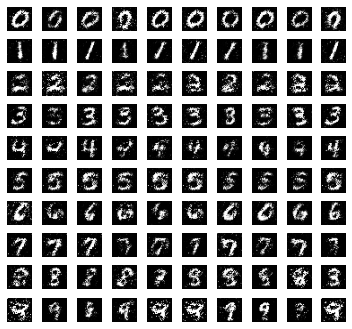

1/1 [==============================] - 0s 20ms/step
Epoch = %d 51
4/4 [==============================] - 0s 4ms/step


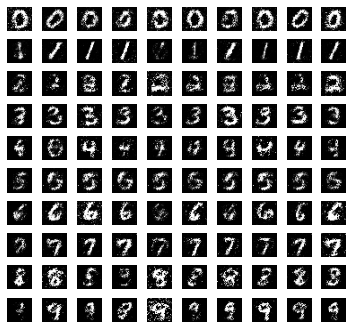

1/1 [==============================] - 0s 28ms/step
Epoch = %d 52
4/4 [==============================] - 0s 3ms/step


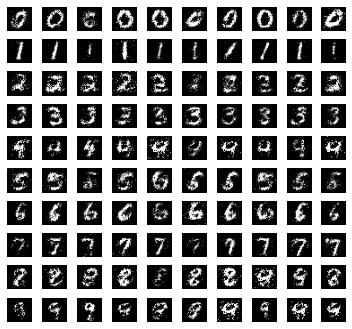

1/1 [==============================] - 0s 21ms/step
Epoch = %d 53
4/4 [==============================] - 0s 4ms/step


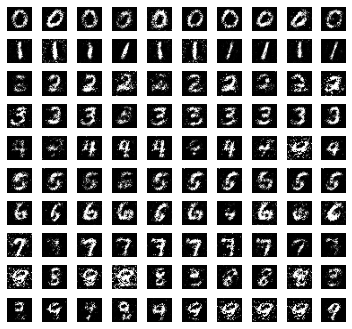

1/1 [==============================] - 0s 21ms/step
Epoch = %d 54
4/4 [==============================] - 0s 5ms/step


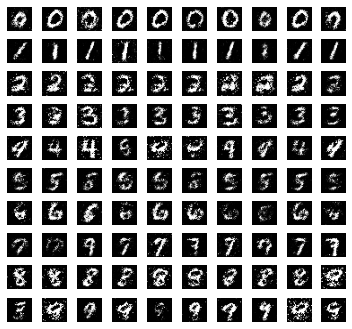

1/1 [==============================] - 0s 20ms/step
Epoch = %d 55
4/4 [==============================] - 0s 4ms/step


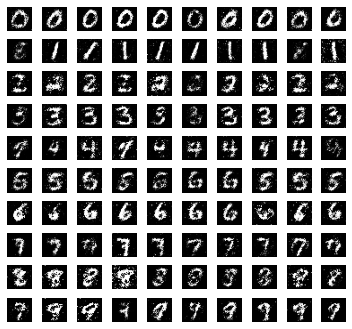

1/1 [==============================] - 0s 23ms/step
Epoch = %d 56
4/4 [==============================] - 0s 4ms/step


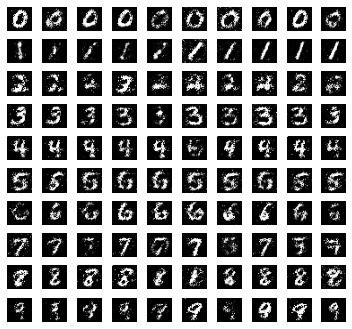

1/1 [==============================] - 0s 23ms/step
Epoch = %d 57
4/4 [==============================] - 0s 4ms/step


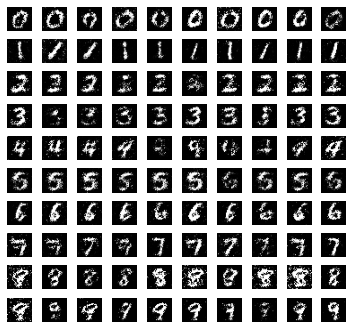

1/1 [==============================] - 0s 22ms/step
Epoch = %d 58
4/4 [==============================] - 0s 4ms/step


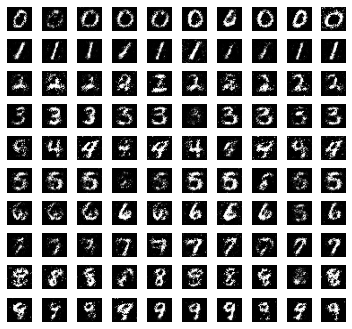

1/1 [==============================] - 0s 25ms/step
Epoch = %d 59
4/4 [==============================] - 0s 4ms/step


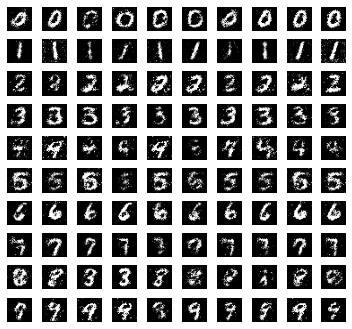

1/1 [==============================] - 0s 29ms/step
Epoch = %d 60
4/4 [==============================] - 0s 3ms/step


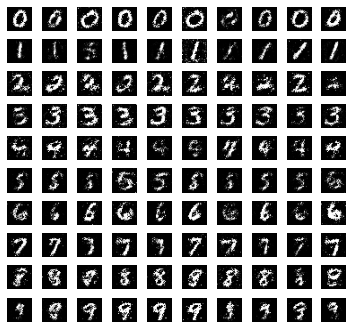

1/1 [==============================] - 0s 22ms/step
Epoch = %d 61
4/4 [==============================] - 0s 4ms/step


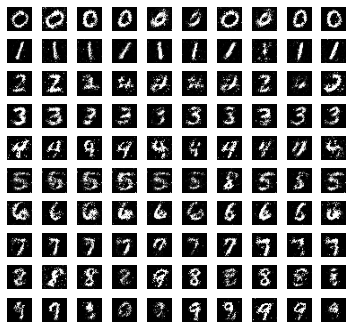

1/1 [==============================] - 0s 20ms/step
Epoch = %d 62
4/4 [==============================] - 0s 3ms/step


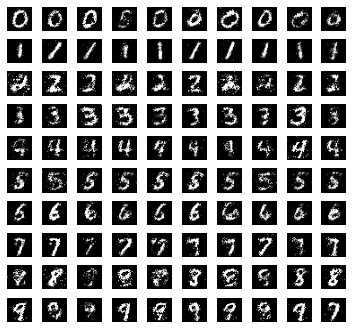

1/1 [==============================] - 0s 20ms/step
Epoch = %d 63
4/4 [==============================] - 0s 4ms/step


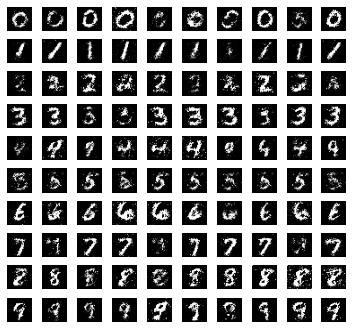

1/1 [==============================] - 0s 20ms/step
Epoch = %d 64
4/4 [==============================] - 0s 4ms/step


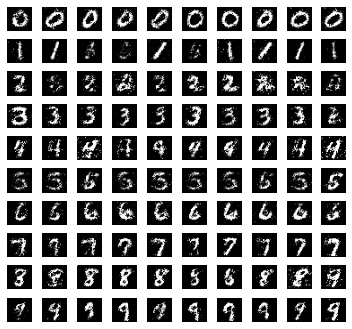

1/1 [==============================] - 0s 21ms/step
Epoch = %d 65
4/4 [==============================] - 0s 3ms/step


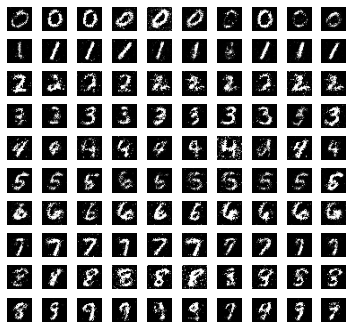

1/1 [==============================] - 0s 24ms/step
Epoch = %d 66
4/4 [==============================] - 0s 4ms/step


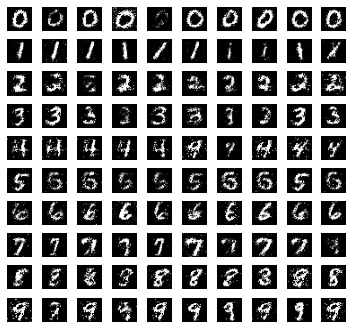

1/1 [==============================] - 0s 22ms/step
Epoch = %d 67
4/4 [==============================] - 0s 3ms/step


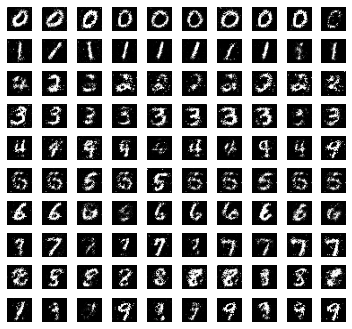

1/1 [==============================] - 0s 22ms/step
Epoch = %d 68
4/4 [==============================] - 0s 3ms/step


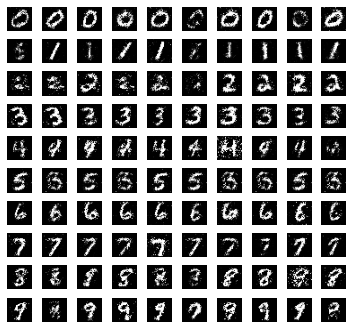

1/1 [==============================] - 0s 20ms/step
Epoch = %d 69
4/4 [==============================] - 0s 4ms/step


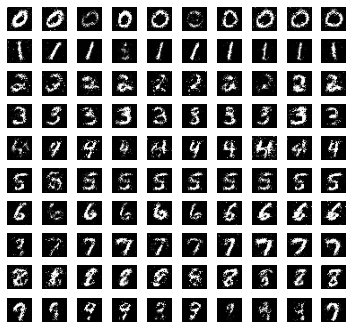

1/1 [==============================] - 0s 23ms/step
Epoch = %d 70
4/4 [==============================] - 0s 4ms/step


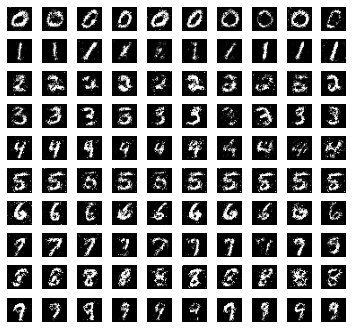

1/1 [==============================] - 0s 20ms/step
Epoch = %d 71
4/4 [==============================] - 0s 4ms/step


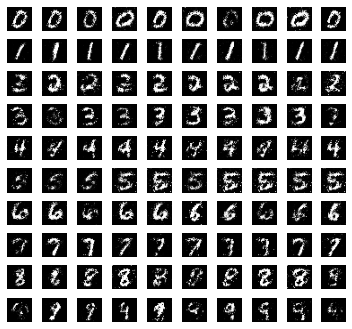

1/1 [==============================] - 0s 23ms/step
Epoch = %d 72
4/4 [==============================] - 0s 4ms/step


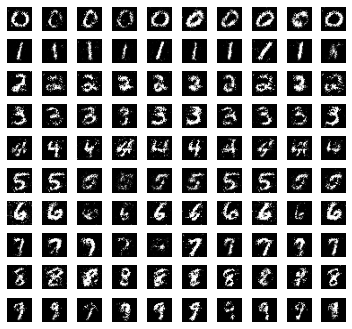

1/1 [==============================] - 0s 22ms/step
Epoch = %d 73
4/4 [==============================] - 0s 3ms/step


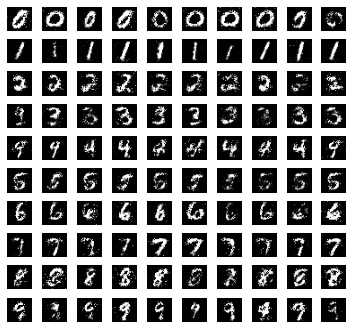

1/1 [==============================] - 0s 27ms/step
Epoch = %d 74
4/4 [==============================] - 0s 4ms/step


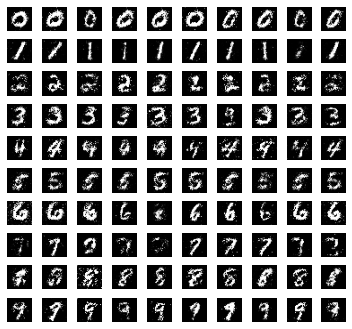

1/1 [==============================] - 0s 23ms/step
Epoch = %d 75
4/4 [==============================] - 0s 3ms/step


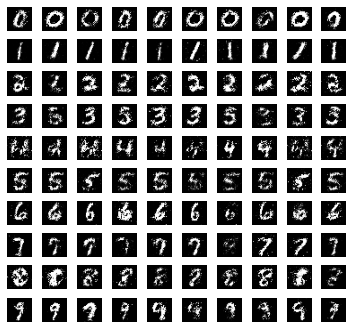

1/1 [==============================] - 0s 26ms/step
Epoch = %d 76
4/4 [==============================] - 0s 4ms/step


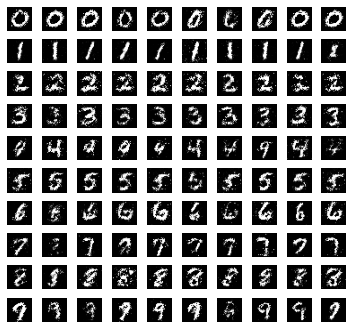

1/1 [==============================] - 0s 23ms/step
Epoch = %d 77
4/4 [==============================] - 0s 4ms/step


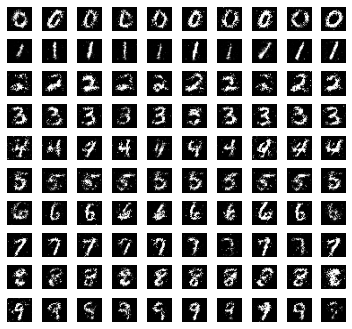

1/1 [==============================] - 0s 22ms/step
Epoch = %d 78
4/4 [==============================] - 0s 3ms/step


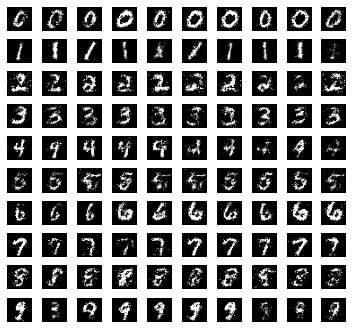

1/1 [==============================] - 0s 25ms/step
Epoch = %d 79
4/4 [==============================] - 0s 4ms/step


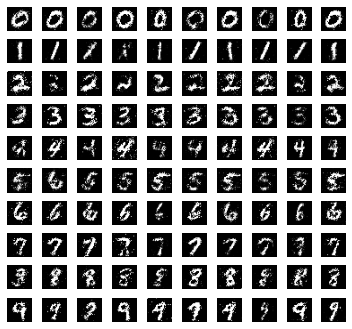

1/1 [==============================] - 0s 21ms/step
Epoch = %d 80
4/4 [==============================] - 0s 4ms/step


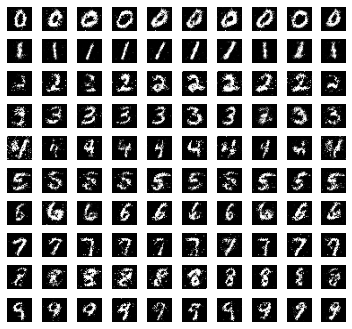

1/1 [==============================] - 0s 20ms/step
Epoch = %d 81
4/4 [==============================] - 0s 4ms/step


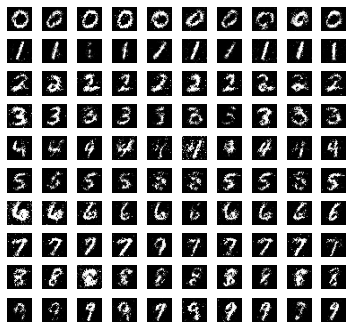

1/1 [==============================] - 0s 20ms/step
Epoch = %d 82
4/4 [==============================] - 0s 4ms/step


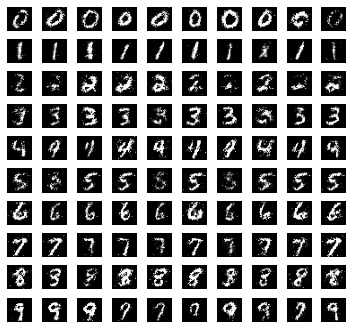

1/1 [==============================] - 0s 20ms/step
Epoch = %d 83
4/4 [==============================] - 0s 3ms/step


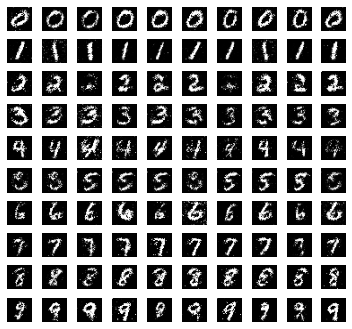

1/1 [==============================] - 0s 20ms/step
Epoch = %d 84
4/4 [==============================] - 0s 4ms/step


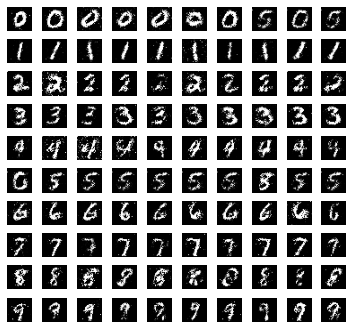

1/1 [==============================] - 0s 21ms/step
Epoch = %d 85
4/4 [==============================] - 0s 3ms/step


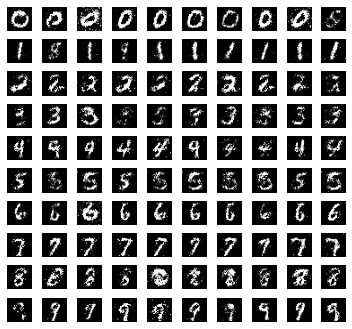

1/1 [==============================] - 0s 26ms/step
Epoch = %d 86
4/4 [==============================] - 0s 4ms/step


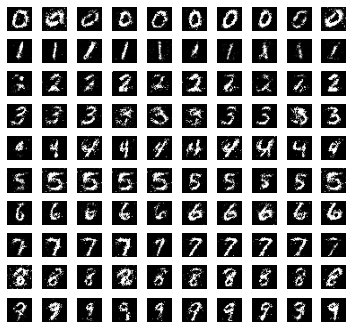

1/1 [==============================] - 0s 22ms/step
Epoch = %d 87
4/4 [==============================] - 0s 4ms/step


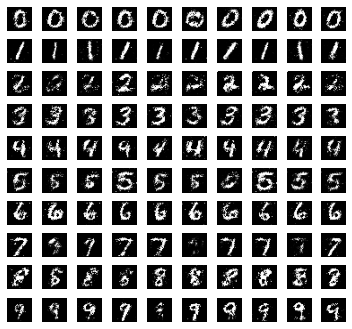

1/1 [==============================] - 0s 27ms/step
Epoch = %d 88
4/4 [==============================] - 0s 4ms/step


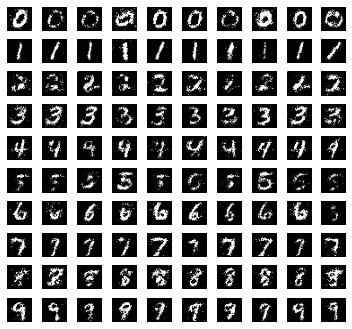

1/1 [==============================] - 0s 20ms/step
Epoch = %d 89
4/4 [==============================] - 0s 4ms/step


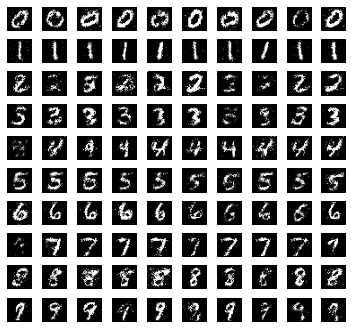

1/1 [==============================] - 0s 21ms/step
Epoch = %d 90
4/4 [==============================] - 0s 4ms/step


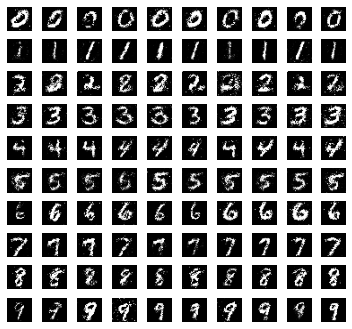

1/1 [==============================] - 0s 20ms/step
Epoch = %d 91
4/4 [==============================] - 0s 3ms/step


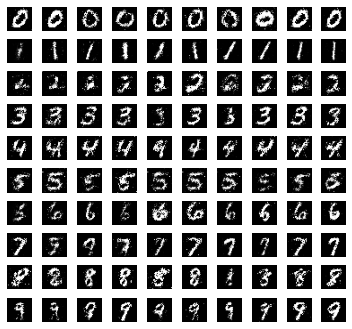

1/1 [==============================] - 0s 24ms/step
Epoch = %d 92
4/4 [==============================] - 0s 4ms/step


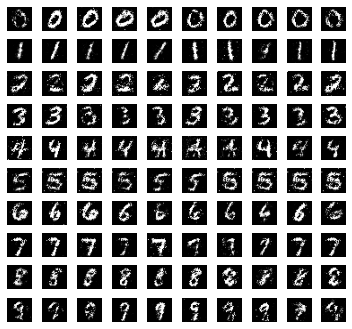

1/1 [==============================] - 0s 22ms/step
Epoch = %d 93
4/4 [==============================] - 0s 4ms/step


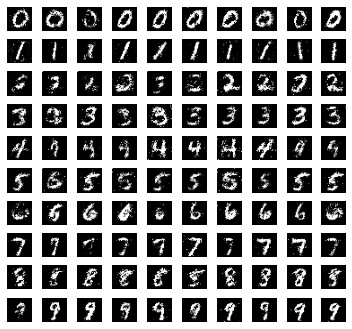

1/1 [==============================] - 0s 24ms/step
Epoch = %d 94
4/4 [==============================] - 0s 3ms/step


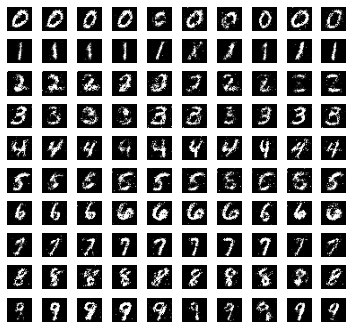

1/1 [==============================] - 0s 20ms/step
Epoch = %d 95
4/4 [==============================] - 0s 4ms/step


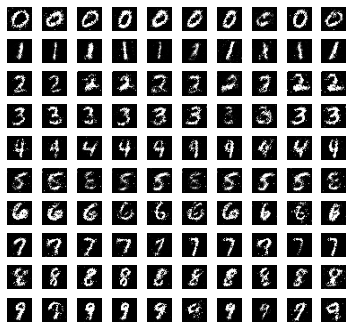

1/1 [==============================] - 0s 21ms/step
Epoch = %d 96
4/4 [==============================] - 0s 3ms/step


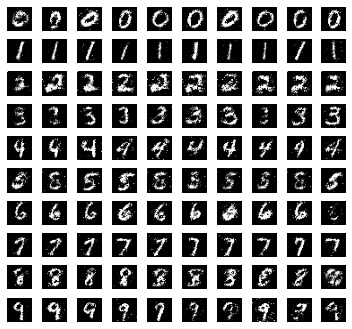

1/1 [==============================] - 0s 34ms/step
Epoch = %d 97
4/4 [==============================] - 0s 3ms/step


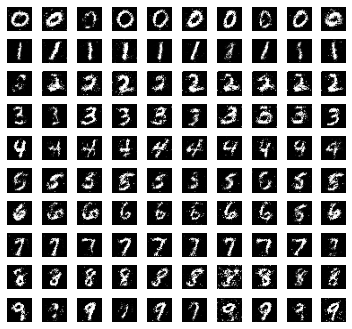

1/1 [==============================] - 0s 22ms/step
Epoch = %d 98
4/4 [==============================] - 0s 4ms/step


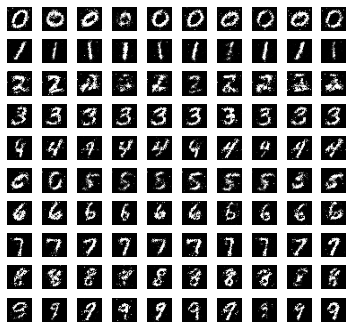

1/1 [==============================] - 0s 22ms/step
Epoch = %d 99
4/4 [==============================] - 0s 4ms/step


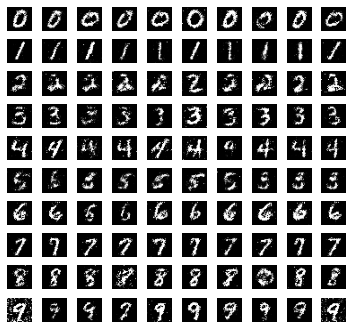

In [ ]:
epochs=100
batch_size=32
valid = np.ones((batch_size, 1))
fake = np.zeros((batch_size, 1))
d_loss_plot = []
g_loss_plot = []
acc_plot = []
for epoch in range(epochs):                                                     #Training loop for each eapoch
  d_loss_batch=0
  g_loss_batch=0
  for i in range(batch_size):                                                   #Inner training loop for each batch
    imgs, labels = X_train[list_split[i]], y_train[list_split[i]]               #import ith batch trainset
    noise = np.random.normal(0, 1, (batch_size, 100))                           #Produce noise as much as batch size
    gen_imgs = generator.predict([noise, labels])                               #generate fake output
    d_loss_real_batch = discriminator.train_on_batch([imgs, labels], valid)     #Train discriminator with real data
    d_loss_fake_batch = discriminator.train_on_batch([gen_imgs, labels], fake)  #Train discriminator with fake data
    d_loss_batch += 0.5 * np.add(d_loss_real_batch, d_loss_fake_batch)          #Calculate loss function
    sampled_labels = np.random.randint(0, 10, batch_size).reshape(-1, 1)        #Produce random label as much as batch size
    g_loss_batch += combined.train_on_batch([noise, sampled_labels], valid)     #Train generator with random label and noise

  d_loss_plot.append(d_loss_batch[0])                                           #Sampled loss function of discriminator
  g_loss_plot.append(g_loss_batch)                                              #Sampled loss function of generator
  acc_plot.append(d_loss_batch[1])                                              #Sampled accuracy of discriminator

  print ("Epoch = %d", epoch)

#produce 100 random noise for generate 10 fake data for each label at every eapoch by generator

  samples = 100
  z = np.random.normal(loc=0, scale=1, size=(samples, 100))
  x_fake = generator.predict([z, rand_labels])

#Plot produced fake datas

  fig = pyplot.figure(figsize=(5,5))
  fig.subplots_adjust(hspace = 0.01, left=0.001, right=0.03)
  fig.suptitle("Epoch %d"%epoch, fontsize=15, va='bottom')
  for k in range(samples):
    pyplot.subplot(10, 10, k+1, frameon=False)
    pyplot.imshow(x_fake[k].reshape(28, 28), cmap='gray')
    pyplot.xticks([])
    pyplot.yticks([])
  plt.tight_layout()
  plt.show()
  fig.savefig("/content/drive/MyDrive/ANN-HW7/Pic/%d.png" % epoch)              #Save each 100 fake data in one picture


# Evaluation

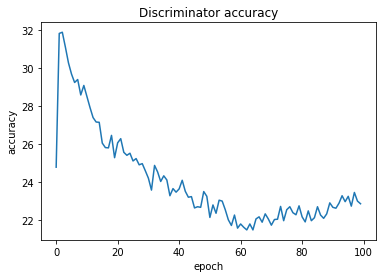

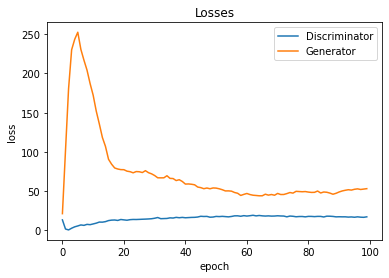

In [ ]:
#Plot loss function of generator and discriminator and accuracy of discriminator

plt.plot(acc_plot)
plt.title('Discriminator accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.show()

plt.plot(d_loss_plot)
plt.plot(g_loss_plot)
plt.title('Losses')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['Discriminator', 'Generator'])
plt.show()

# Generate gif from saved fake data

In [ ]:
import os
import imageio

png_dir = '/content/drive/MyDrive/ANN-HW7/Pic'
images = []
for file_name in sorted(os.listdir(png_dir)):
    if file_name.endswith('.png'):
        file_path = os.path.join(png_dir, file_name)
        images.append(imageio.imread(file_path))

imageio.mimsave('/content/drive/MyDrive/ANN-HW7/Pic/GAN.gif', images,fps=1)

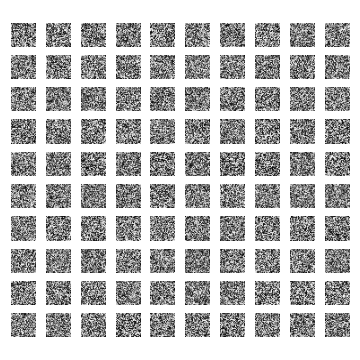

In [ ]:
from IPython.display import Image
with open('/content/drive/MyDrive/ANN-HW7/Pic/GAN.gif','rb') as file:
    display(Image(file.read()))